In [1]:
# Mensud Basic, Kevin Luu, Kathleen Killian
# CIS 435 - Northwestern University

#!pip install wandb -qq
import pandas as pd  # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np  # linear algebra
import matplotlib.pyplot as plt  # for data visualization purposes
import seaborn as sns # for statistical data visualization
#import category_encoders as ce
import plotly.express as px
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn.metrics import accuracy_score, roc_auc_score, classification_report, plot_confusion_matrix, plot_roc_curve
from sklearn.preprocessing import LabelEncoder
from sklearn import preprocessing
from sklearn.preprocessing import OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
import seaborn as seabornInstance 
from sklearn import metrics
#import eli5 
#from eli5.sklearn import PermutationImportance
import statsmodels.api as sm
import time
import warnings
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error
#import wandb
#wandb.init(project="sklearn")
%matplotlib inline

ImportError: cannot import name 'plot_confusion_matrix' from 'sklearn.metrics' (C:\Users\klboy\anaconda3\lib\site-packages\sklearn\metrics\__init__.py)

In [2]:
dataset = pd.read_csv('airlines.csv')

In [3]:
# view dimensions of dataset
dataset.shape

(539383, 9)

In [4]:
# preview the dataset
dataset.head()

,id,Airline,Flight,AirportFrom,AirportTo,DayOfWeek,Time,Length,Delay
0,1,CO,269,SFO,IAH,3,15,205,1
1,2,US,1558,PHX,CLT,3,15,222,1
2,3,AA,2400,LAX,DFW,3,20,165,1
3,4,AA,2466,SFO,DFW,3,20,195,1
4,5,AS,108,ANC,SEA,3,30,202,0


In [5]:
dataset.describe()

,id,Flight,DayOfWeek,Time,Length,Delay
count,539383.00000,539383.000000,539383.000000,539383.000000,539383.000000,539383.000000
mean,269692.00000,2427.928630,3.929668,802.728963,132.202007,0.445442
std,155706.60446,2067.429837,1.914664,278.045911,70.117016,0.497015
min,1.00000,1.000000,1.000000,10.000000,0.000000,0.000000
25%,134846.50000,712.000000,2.000000,565.000000,81.000000,0.000000
50%,269692.00000,1809.000000,4.000000,795.000000,115.000000,0.000000
75%,404537.50000,3745.000000,5.000000,1035.000000,162.000000,1.000000
max,539383.00000,7814.000000,7.000000,1439.000000,655.000000,1.000000


In [6]:
#check for nulls
dataset.isnull().sum()

id             0
Airline        0
Flight         0
AirportFrom    0
AirportTo      0
DayOfWeek      0
Time           0
Length         0
Delay          0
dtype: int64

In [7]:
# need to drop off id column
dataset.drop(['id'],axis=1,inplace=True)

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 539383 entries, 0 to 539382
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype 
---  ------       --------------   ----- 
 0   Airline      539383 non-null  object
 1   Flight       539383 non-null  int64 
 2   AirportFrom  539383 non-null  object
 3   AirportTo    539383 non-null  object
 4   DayOfWeek    539383 non-null  int64 
 5   Time         539383 non-null  int64 
 6   Length       539383 non-null  int64 
 7   Delay        539383 non-null  int64 
dtypes: int64(5), object(3)
memory usage: 32.9+ MB


In [9]:
#view the unique values in Airlines
print(dataset.Airline.unique())

['CO' 'US' 'AA' 'AS' 'DL' 'B6' 'HA' 'OO' '9E' 'OH' 'EV' 'XE' 'YV' 'UA'
 'MQ' 'FL' 'F9' 'WN']


In [10]:
#view the unique values in AirportFrom
print(dataset.AirportFrom.unique())

['SFO' 'PHX' 'LAX' 'ANC' 'LAS' 'SLC' 'DEN' 'ONT' 'FAI' 'BQN' 'PSE' 'HNL'
 'BIS' 'IYK' 'EWR' 'BOS' 'MKE' 'GFK' 'OMA' 'GSO' 'LMT' 'SEA' 'MCO' 'TPA'
 'DLH' 'MSP' 'FAR' 'MFE' 'MSY' 'VPS' 'BWI' 'MAF' 'LWS' 'RST' 'ALB' 'DSM'
 'CHS' 'MSN' 'JAX' 'SAT' 'PNS' 'BHM' 'LIT' 'SAV' 'BNA' 'ICT' 'ECP' 'DHN'
 'MGM' 'CAE' 'PWM' 'ACV' 'EKO' 'PHL' 'ATL' 'PDX' 'RIC' 'BTR' 'HRL' 'MYR'
 'TUS' 'SBN' 'CAK' 'TVC' 'CLE' 'ORD' 'DAY' 'MFR' 'BTV' 'TLH' 'TYS' 'DFW'
 'FLL' 'AUS' 'CHA' 'CMH' 'LRD' 'BRO' 'CRP' 'LAN' 'PVD' 'FWA' 'JFK' 'LGA'
 'OKC' 'PIT' 'PBI' 'ORF' 'DCA' 'AEX' 'SYR' 'SHV' 'VLD' 'BDL' 'FAT' 'BZN'
 'RDM' 'LFT' 'IPL' 'EAU' 'ERI' 'BUF' 'IAH' 'MCI' 'AGS' 'ABI' 'GRR' 'LBB'
 'CLT' 'LEX' 'MBS' 'MOD' 'AMA' 'SGF' 'AZO' 'ABE' 'SWF' 'BGM' 'AVP' 'FNT'
 'GSP' 'ATW' 'ITH' 'TUL' 'COS' 'ELP' 'ABQ' 'SMF' 'STL' 'IAD' 'DTW' 'RDU'
 'RSW' 'OAK' 'ROC' 'IND' 'CVG' 'MDW' 'SDF' 'ABY' 'TRI' 'XNA' 'ROA' 'MLI'
 'LYH' 'EVV' 'HPN' 'FAY' 'EWN' 'CSG' 'GPT' 'MLU' 'MOB' 'OAJ' 'CHO' 'ILM'
 'BMI' 'PHF' 'ACY' 'JAN' 'CID' 'GRK' 'HOU' 'CRW' 'H

In [11]:
#view the unique values in AirportFrom
print(dataset.AirportTo.unique())

['IAH' 'CLT' 'DFW' 'SEA' 'MSP' 'DTW' 'ORD' 'ATL' 'PDX' 'JFK' 'SLC' 'HNL'
 'PHX' 'MCO' 'OGG' 'LAX' 'KOA' 'ITO' 'SFO' 'MIA' 'IAD' 'SMF' 'PHL' 'LIH'
 'DEN' 'LGA' 'MEM' 'CVG' 'YUM' 'CWA' 'MKE' 'BQN' 'FAI' 'LAS' 'ANC' 'BOS'
 'LGB' 'FLL' 'SJU' 'EWR' 'DCA' 'BWI' 'RDU' 'MCI' 'TYS' 'SAN' 'ONT' 'OAK'
 'MDW' 'BNA' 'DAL' 'CLE' 'JAX' 'JNU' 'RNO' 'ELP' 'SAT' 'OTZ' 'MBS' 'BDL'
 'STL' 'HOU' 'AUS' 'SNA' 'SJC' 'LIT' 'TUS' 'TUL' 'CMH' 'LAN' 'IND' 'AMA'
 'CRP' 'PIT' 'RKS' 'FWA' 'TPA' 'PBI' 'JAN' 'DSM' 'ADQ' 'GRB' 'PVD' 'ABQ'
 'SDF' 'RSW' 'MSY' 'BUR' 'BOI' 'TLH' 'BHM' 'ACV' 'ORF' 'BET' 'KTN' 'RIC'
 'SRQ' 'BTR' 'XNA' 'MHT' 'GRR' 'SBN' 'SBA' 'ROA' 'CID' 'GPT' 'MFR' 'SGU'
 'HPN' 'OMA' 'OTH' 'GSP' 'LMT' 'BUF' 'MSN' 'BFL' 'CAE' 'HRL' 'OKC' 'SYR'
 'COS' 'BTV' 'CDC' 'SCC' 'DAY' 'SJT' 'TVC' 'ROC' 'ISP' 'MRY' 'SBP' 'MLI'
 'MOB' 'CIC' 'SAV' 'FAT' 'EKO' 'GEG' 'ECP' 'LFT' 'SUN' 'HSV' 'SHV' 'CHA'
 'CAK' 'BZN' 'MAF' 'GSO' 'MDT' 'PHF' 'ICT' 'AZO' 'RAP' 'CHS' 'CLD' 'MKG'
 'VPS' 'PIH' 'ATW' 'AGS' 'PNS' 'BIL' 'SPI' 'FAR' 'C

### Frequency Reviews

In [12]:
freq_table_A = pd.crosstab(dataset['Airline'], dataset['Delay'])
freq_table_A

#maybe add % delays and sort on highest percentage

#Continental Airlines (CO) is 57% delayed 
#Mesa Airlines (YV) is only 3% delayed
#Southwest Airlines (WN) is 70% delayed

Delay,0,1
Airline,,
9E,12460,8226
AA,27920,17736
AS,7579,3892
B6,9653,8459
CO,9161,11957
DL,33488,27452
EV,16728,11255
F9,3557,2899
FL,14552,6275


In [13]:
freq_table_F = pd.crosstab(dataset['Flight'], dataset['Delay'])
freq_table_F

#maybe add % delays and sort on highest percentage

Delay,0,1
Flight,,
1,139,150
2,130,111
3,146,101
4,156,127
5,217,190
...,...,...
7810,9,5
7811,37,25
7812,23,39


In [14]:
freq_table_DOW = pd.crosstab(dataset['DayOfWeek'], dataset['Delay'])
freq_table_DOW

#maybe add % delays and sort on highest percentage

Delay,0,1
DayOfWeek,,
1,38739,34030
2,39427,31913
3,47492,42254
4,50201,41244
5,49733,35515
6,35341,23615
7,38186,31693


In [15]:
freq_table_L = pd.crosstab(dataset['Length'], dataset['Delay'])
freq_table_L

#maybe add % delays and sort on highest percentage

Delay,0,1
Length,,
0,3,1
23,0,1
24,9,0
25,12,10
26,10,10
...,...,...
560,5,19
570,15,16
610,0,6


In [16]:
freq_table_AT = pd.crosstab(dataset['AirportTo'], dataset['Delay'])
freq_table_AT

#maybe add % delays and sort on highest percentage

Delay,0,1
AirportTo,,
ABE,170,135
ABI,141,70
ABQ,1157,1643
ABR,1,1
ABY,60,27
...,...,...
VPS,398,235
WRG,38,21
XNA,718,405


In [17]:
freq_table_T = pd.crosstab(dataset['Time'], dataset['Delay'])
freq_table_T

#maybe add % delays and sort on highest percentage

Delay,0,1
Time,,
10,17,3
15,23,50
20,31,35
21,0,1
25,7,4
...,...,...
1428,8,2
1430,48,27
1431,13,7


### Categorical Variables Review

In [18]:
# find categorical variables

categorical = [var for var in dataset.columns if dataset[var].dtype=='O']
print('There are {} categorical variables\n'.format(len(categorical)))
print('The categorical variables are :\n\n', categorical)

There are 3 categorical variables

The categorical variables are :

 ['Airline', 'AirportFrom', 'AirportTo']


In [19]:
# view the categorical variables
dataset[categorical].head()

,Airline,AirportFrom,AirportTo
0,CO,SFO,IAH
1,US,PHX,CLT
2,AA,LAX,DFW
3,AA,SFO,DFW
4,AS,ANC,SEA


In [20]:
freq_table_AF = pd.crosstab(dataset['AirportFrom'], dataset['Delay'])
freq_table_AF

Delay,0,1
AirportFrom,,
ABE,232,110
ABI,179,32
ABQ,1424,1375
ABR,1,1
ABY,65,22
...,...,...
VPS,423,210
WRG,41,18
XNA,811,317


In [21]:
# view frequency distribution of categorical variables
for var in categorical: 
    print(dataset[var].value_counts()/np.float64(len(dataset)))

WN    0.174453
DL    0.112981
OO    0.093169
AA    0.084645
MQ    0.067865
US    0.063962
XE    0.057707
EV    0.051880
UA    0.051205
CO    0.039152
FL    0.038613
9E    0.038351
B6    0.033579
YV    0.025446
OH    0.023416
AS    0.021267
F9    0.011969
HA    0.010341
Name: Airline, dtype: float64
ATL    0.063867
ORD    0.046019
DFW    0.041073
DEN    0.036788
LAX    0.030882
         ...   
MMH    0.000030
SJT    0.000028
GUM    0.000019
ADK    0.000017
ABR    0.000004
Name: AirportFrom, Length: 293, dtype: float64
ATL    0.063851
ORD    0.046110
DFW    0.041071
DEN    0.036798
LAX    0.030880
         ...   
MMH    0.000030
SJT    0.000028
GUM    0.000019
ADK    0.000017
ABR    0.000004
Name: AirportTo, Length: 293, dtype: float64


In [22]:
# check for cardinality in categorical variables
for var in categorical:    
    print(var, ' contains ', len(dataset[var].unique()), ' labels')

Airline  contains  18  labels
AirportFrom  contains  293  labels
AirportTo  contains  293  labels


In [23]:
# view frequency counts of values in categorical variables
for var in categorical:
      print(dataset[var].value_counts())

WN    94097
DL    60940
OO    50254
AA    45656
MQ    36605
US    34500
XE    31126
EV    27983
UA    27619
CO    21118
FL    20827
9E    20686
B6    18112
YV    13725
OH    12630
AS    11471
F9     6456
HA     5578
Name: Airline, dtype: int64
ATL    34449
ORD    24822
DFW    22154
DEN    19843
LAX    16657
       ...  
MMH       16
SJT       15
GUM       10
ADK        9
ABR        2
Name: AirportFrom, Length: 293, dtype: int64
ATL    34440
ORD    24871
DFW    22153
DEN    19848
LAX    16656
       ...  
MMH       16
SJT       15
GUM       10
ADK        9
ABR        2
Name: AirportTo, Length: 293, dtype: int64


### By Variable, check the # of delays vs no delays

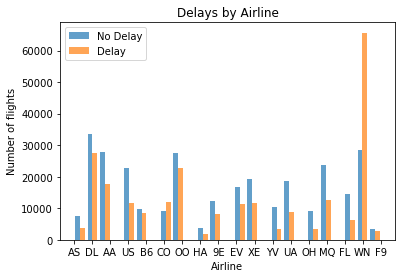

In [24]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["Airline"][dataset["Delay"] == 0], dataset["Airline"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Airline", ylabel="Number of flights")
ax1.set_title("Delays by Airline")
ax1.legend()

#WN = Southwest Airlines has the most delays vs no delays



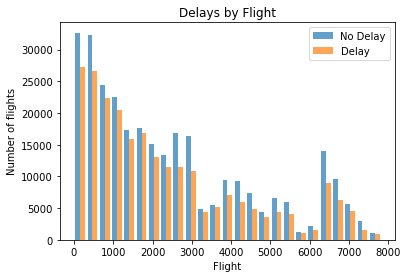

In [25]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["Flight"][dataset["Delay"] == 0], dataset["Flight"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Flight", ylabel="Number of flights")
ax1.set_title("Delays by Flight")
ax1.legend()



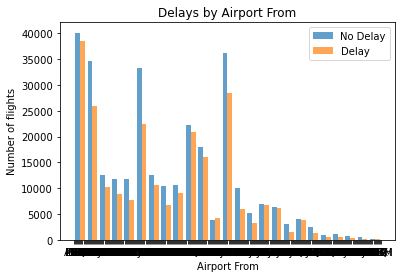

In [26]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["AirportFrom"][dataset["Delay"] == 0], dataset["AirportFrom"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Airport From", ylabel="Number of flights")
ax1.set_title("Delays by Airport From")
ax1.legend()

#how to make width larger??



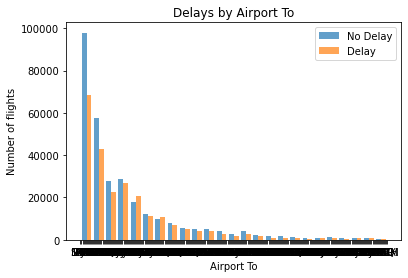

In [27]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["AirportTo"][dataset["Delay"] == 0], dataset["AirportTo"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Airport To", ylabel="Number of flights")
ax1.set_title("Delays by Airport To")
ax1.legend()

#How to make width bigger?

#looks like there is one with more delays than no delays


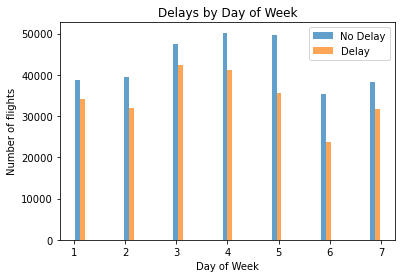

In [28]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["DayOfWeek"][dataset["Delay"] == 0], dataset["DayOfWeek"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Day of Week", ylabel="Number of flights")
ax1.set_title("Delays by Day of Week")
ax1.legend()

#less proportion of delays on Friday-5 and Saturday-6


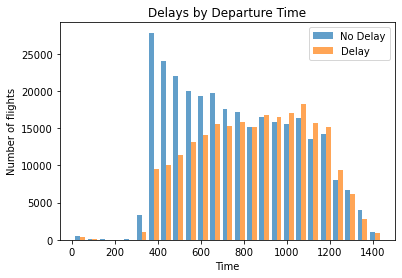

In [29]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["Time"][dataset["Delay"] == 0], dataset["Time"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Time", ylabel="Number of flights")
ax1.set_title("Delays by Departure Time")
ax1.legend()

#morning flights have higher distribution of "no delays", than "delays"


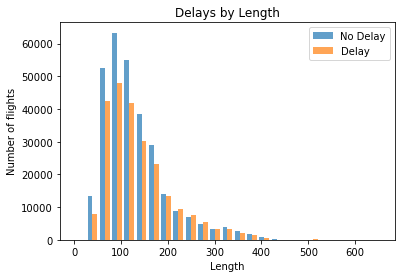

In [30]:
fig, (ax1) = plt.subplots(1, 1)
ax1.hist([dataset["Length"][dataset["Delay"] == 0], dataset["Length"][dataset["Delay"] == 1]], 25, alpha = .7, histtype='bar', label=["No Delay","Delay"])
ax1.set(xlabel="Length", ylabel="Number of flights")
ax1.set_title("Delays by Length")
ax1.legend()

#200-300 seem to have more proportion of delays


### Numerical Values Review

In [31]:
# find numerical variables
numerical = [var for var in dataset.columns if dataset[var].dtype!='O']
print('There are {} numerical variables\n'.format(len(numerical)))
print('The numerical variables are :', numerical)

There are 5 numerical variables

The numerical variables are : ['Flight', 'DayOfWeek', 'Time', 'Length', 'Delay']


In [32]:
# view the numerical variables
dataset[numerical].head()

,Flight,DayOfWeek,Time,Length,Delay
0,269,3,15,205,1
1,1558,3,15,222,1
2,2400,3,20,165,1
3,2466,3,20,195,1
4,108,3,30,202,0


In [33]:
# check missing values in numerical variables
dataset[numerical].isnull().sum()

Flight       0
DayOfWeek    0
Time         0
Length       0
Delay        0
dtype: int64

In [34]:
# No missing values in numerical variables 

In [35]:
dataset.cov()

,Flight,DayOfWeek,Time,Length,Delay
Flight,4.274266e+06,1.647822,-3305.149311,-49501.783071,-47.446428
DayOfWeek,1.647822e+00,3.665940,0.677920,1.798568,-0.024932
Time,-3.305149e+03,0.677920,77309.528522,-401.846248,20.791657
Length,-4.950178e+04,1.798568,-401.846248,4916.395876,1.411026
Delay,-4.744643e+01,-0.024932,20.791657,1.411026,0.247024


In [36]:

dataset.corr()

,Flight,DayOfWeek,Time,Length,Delay
Flight,1.000000,0.000416,-0.005750,-0.341481,-0.046175
DayOfWeek,0.000416,1.000000,0.001273,0.013397,-0.026199
Time,-0.005750,0.001273,1.000000,-0.020612,0.150454
Length,-0.341481,0.013397,-0.020612,1.000000,0.040489
Delay,-0.046175,-0.026199,0.150454,0.040489,1.000000


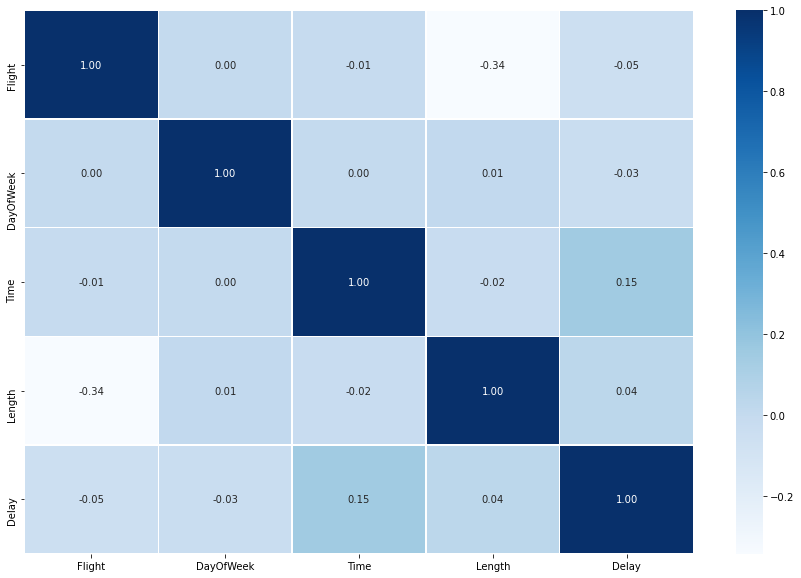

In [37]:
# I use plot to see a correlation better
fig, ax = plt.subplots(figsize=(15,10))
ax = sns.heatmap(dataset.corr(), annot=True, linewidth=0.2, fmt=".2f", cmap="Blues");

In [38]:
# check missing values in numerical variables
dataset[numerical].isnull().sum()

Flight       0
DayOfWeek    0
Time         0
Length       0
Delay        0
dtype: int64

### Boxplots

In [39]:
#create a box plot for age
fig = px.box(dataset, y="Flight")
fig.show()

In [40]:
#create a box plot for age
fig = px.box(dataset, y="Time")
fig.show()

In [41]:
#create a box plot for age
fig = px.box(dataset, y="Length")
fig.show()

In [42]:
#create a box plot for age
fig = px.box(dataset, y="Length")
fig.show()

### Outliers

In [43]:
#create a function to find outliers using IQR

def find_outliers_IQR(dataset):
   q1=dataset.quantile(0.25)
   q3=dataset.quantile(0.75)
   IQR=q3-q1
   outliers = dataset[((dataset<(q1-1.5*IQR)) | (dataset>(q3+1.5*IQR)))]
   return outliers

In [44]:
#First run fare_amount through the function to return a series of the outliers.

outliers = find_outliers_IQR(dataset["Length"])
print("number of outliers: "+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value: "+ str(outliers.min()))

number of outliers: 25650
max outlier value: 655
min outlier value: 284


In [45]:
dataset.describe()['Length']

count    539383.000000
mean        132.202007
std          70.117016
min           0.000000
25%          81.000000
50%         115.000000
75%         162.000000
max         655.000000
Name: Length, dtype: float64

In [46]:
def impute_outliers_IQR(df):
   q1=df.quantile(0.25)
   q3=df.quantile(0.75)
   IQR=q3-q1
   upper = df[~(df>(q3+1.5*IQR))].max()
   lower = df[~(df<(q1-1.5*IQR))].min()
   df = np.where(df > upper,
       df.mean(),
       np.where(
           df < lower,
           df.mean(),
           df
           )
       )
   return df

In [47]:
dataset['Length'] = impute_outliers_IQR(dataset['Length'])
dataset.describe()['Length']

count    539383.000000
mean        122.407183
std          52.066793
min           0.000000
25%          81.000000
50%         115.000000
75%         152.000000
max         283.000000
Name: Length, dtype: float64

In [48]:
#First run fare_amount through the function to return a series of the outliers.

outliers = find_outliers_IQR(dataset["Length"])
print("number of outliers: "+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value: "+ str(outliers.min()))

number of outliers: 10338
max outlier value: 283.0
min outlier value: 259.0


### Converting Categorical to Numerical

In [49]:
labeling = preprocessing.LabelEncoder()

dataset['Airline'] = labeling.fit_transform(dataset['Airline'])
dataset['AirportFrom'] = labeling.fit_transform(dataset['AirportFrom'])
dataset['AirportTo'] = labeling.fit_transform(dataset['AirportTo'])

NameError: name 'preprocessing' is not defined

In [50]:
dataset

,Airline,Flight,AirportFrom,AirportTo,DayOfWeek,Time,Length,Delay
0,CO,269,SFO,IAH,3,15,205.000000,1
1,US,1558,PHX,CLT,3,15,222.000000,1
2,AA,2400,LAX,DFW,3,20,165.000000,1
3,AA,2466,SFO,DFW,3,20,195.000000,1
4,AS,108,ANC,SEA,3,30,202.000000,0
...,...,...,...,...,...,...,...,...
539378,CO,178,OGG,SNA,5,1439,132.202007,0
539379,FL,398,SEA,ATL,5,1439,132.202007,0
539380,FL,609,SFO,MKE,5,1439,255.000000,0
539381,UA,78,HNL,SFO,5,1439,132.202007,1


### Overall Correlation

In [51]:
corr_matrix = dataset.corr()
print(corr_matrix)

             Flight  DayOfWeek      Time    Length     Delay
Flight     1.000000   0.000416 -0.005750 -0.304059 -0.046175
DayOfWeek  0.000416   1.000000  0.001273  0.011616 -0.026199
Time      -0.005750   0.001273  1.000000 -0.046434  0.150454
Length    -0.304059   0.011616 -0.046434  1.000000  0.045509
Delay     -0.046175  -0.026199  0.150454  0.045509  1.000000


In [52]:
seabornInstance.heatmap(corr_matrix, annot=True)
plt.show()

#Time has the highest, but only 15% correlation, to delays
#There is correlation between parameters

NameError: name 'seabornInstance' is not defined

### K means

In [53]:
# select features to be considered in clustering
    
x1 = dataset['Airline'].values
x2 = dataset['Flight'].values
x3 = dataset['AirportFrom'].values
x4 = dataset['AirportTo'].values
x5 = dataset['DayOfWeek'].values
x6 = dataset['Time'].values
x7= dataset['Length'].values
x8= dataset['Delay'].values

A = np.array(list(zip(x1,x2, x3, x4,x5,x6,x7,x8)))



In [54]:
from sklearn.cluster import KMeans

# Number of clusters
kmeans = KMeans(n_clusters=3)
# Fitting the input data
kmeans = kmeans.fit(A)
# Getting the cluster labels
labels = kmeans.predict(A)
# Centroid values
centroids = kmeans.cluster_centers_

labels = kmeans.labels_


ValueError: could not convert string to float: 'B6'

In [55]:
# Comparing with scikit-learn centroids

print(centroids) # From sci-kit learn

NameError: name 'centroids' is not defined

In [ ]:
colors = ["g.","r.","c.","y."]

for i in range(len(A)):
    print("coordinate:",A[i], "label:", labels[i])
    plt.plot(A[i][0], A[i][1], colors[labels[i]], markersize = 10)

plt.scatter(centroids[:, 0],centroids[:, 1], marker = "x", s=150, 
            linewidths = 5, zorder = 10)

plt.show()

In [ ]:
predict = kmeans.predict(A)
dataset['cluster'] = predict
pd.plotting.parallel_coordinates(dataset, 'cluster')

In [ ]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(dataset)
    distortions.append(kmeanModel.inertia_)

In [ ]:
plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

### Train, Test, Split

In [ ]:
from sklearn.model_selection import train_test_split

X = dataset.drop('Delay', axis=1)
y = dataset['Delay']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state=0)

### Decision Tree

In [ ]:
tree = DecisionTreeClassifier(max_depth=6,random_state=0)
tree.fit(X_train, y_train)
print("Accuracy on training set: {:.4f}".format(tree.score(X_train, y_train)))
print("Accuracy on test set: {:.4f}".format(tree.score(X_test, y_test)))

#Feature importance rates how important each feature is for the decision a tree makes. It is a number between 0 and 1 for each feature, where 0 means “not used at all” and 1 means “perfectly predicts the target.” 
#The feature importances always sum to 1

print("Feature importances:\n{}".format(tree.feature_importances_))

#Confusion Matrix
y_pred = tree.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

# Precision/Recall
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
DT_roc_auc = roc_auc_score(y_test, tree.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, tree.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Decision Tree' % DT_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('DT_ROC')
plt.show()

# calculate AUC

print('AUC: %.3f' % metrics.auc(fpr, tpr))


### Logistic Regression

In [ ]:
logreg = LogisticRegression().fit(X_train, y_train)
print("Training set accuracy: {:.4f}".format(logreg.score(X_train, y_train)))
print("Test set accuracy: {:.4f}".format(logreg.score(X_test, y_test)))


logreg.coef_.T

print("Feature importances:\n{}".format(logreg.coef_.T))

In [ ]:
#Confusion Matrix
y_pred = logreg.predict(X_test)
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

# Precision/Recall
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
logit_roc_auc = roc_auc_score(y_test, logreg.predict(X_test))
fpr, tpr, thresholds = roc_curve(y_test, logreg.predict_proba(X_test)[:,1])
plt.figure()
plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.savefig('Log_ROC')
plt.show()

# calculate AUC

print('AUC: %.3f' % metrics.auc(fpr, tpr))


### Support Vector Machine (SVM)

In [ ]:
# Support Vector Machine

#from sklearn.svm import SVC
#from sklearn.preprocessing import MinMaxScaler

# SVM requires all the features to vary on a similar scale. We will need to rescale our data that all the features are approximately on the same scale
#scaler = MinMaxScaler()
#X_train_scaled = scaler.fit_transform(X_train)
#X_test_scaled = scaler.fit_transform(X_test)
#
#svc = SVC(probability=True)
#svc.fit(X_train_scaled, y_train)

#print("Accuracy on training set: {:.2f}".format(svc.score(X_train_scaled, y_train)))
#print("Accuracy on test set: {:.2f}".format(svc.score(X_test_scaled, y_test)))
#print("Feature importances:\n{}".format(gb.feature_importances_))

#Confusion Matrix
#y_pred = svc.predict(X_test_scaled)
#from sklearn.metrics import confusion_matrix
#confusion_matrix = confusion_matrix(y_test, y_pred)
#print(confusion_matrix)

# Precision/Recall
#from sklearn.metrics import classification_report
#print(classification_report(y_test, y_pred))



#from sklearn.metrics import roc_auc_score
#from sklearn.metrics import roc_curve
#SVM_roc_auc = roc_auc_score(y_test, svc.predict(X_test_scaled))
#fpr, tpr, thresholds = roc_curve(y_test, svc.predict_proba(X_test_scaled)[:,1])
#plt.figure()
#plt.plot(fpr, tpr, label='SVM' % SVM_roc_auc)
#plt.plot([0, 1], [0, 1],'r--')
#plt.xlim([0.0, 1.0])
#plt.ylim([0.0, 1.05])
#plt.xlabel('False Positive Rate')
#plt.ylabel('True Positive Rate')
#plt.title('Receiver operating characteristic')
#plt.legend(loc="lower right")
#plt.savefig('RF_ROC')
#plt.show()

# calculate AUC

#print('AUC: %.3f' % metrics.auc(fpr, tpr))
